## Implementações das Classes

In [1]:
# prompt: crie uma classe chamada SpacialFilters que armazena filtros espaciais como tuplas de: uma constante e a matriz de pesos
# adicione também um filtro gaussiano 5x5; um filtro passa alta 5x5 e um passa baixa 5x5

import numpy as np
class SpacialFilters:
    """
    Classe para armazenar e gerenciar filtros espaciais.
    Os filtros são armazenados como tuplas de (constante, matriz_pesos).
    """

    def __init__(self):
        self.filters = {}

        # Adiciona o filtro Gaussiano 5x5
        gaussian_kernel_5x5 = np.array([
            [1,  4,  7,  4,  1],
            [4, 16, 26, 16,  4],
            [7, 26, 41, 26,  7],
            [4, 16, 26, 16,  4],
            [1,  4,  7,  4,  1]
        ])
        gaussian_constant = 1.0 / 273.0
        self.add_filter("gaussian_5x5", gaussian_constant, gaussian_kernel_5x5)

        # Adiciona o filtro Passa Alta 5x5
        highpass_kernel_5x5 = np.array([
            [-1, -1, -1, -1, -1],
            [-1, -1, -1, -1, -1],
            [-1, -1, 24, -1, -1],
            [-1, -1, -1, -1, -1],
            [-1, -1, -1, -1, -1]
        ])
        highpass_constant = 1.0
        self.add_filter("highpass_5x5", highpass_constant, highpass_kernel_5x5)

        # Adiciona o filtro Passa Baixa 5x5 (Média 5x5)
        lowpass_kernel_5x5 = np.ones((5, 5))
        lowpass_constant = 1.0 / 25.0
        self.add_filter("lowpass_5x5", lowpass_constant, lowpass_kernel_5x5)

        # Adiciona o filtro Passa Baixa 3x3 (Média 3x3)
        lowpass_kernel_3x3 = np.ones((3, 3))
        lowpass_constant = 1.0 / 9.0
        self.add_filter("lowpass_3x3", lowpass_constant, lowpass_kernel_3x3)

        # FILTROS DE AGUÇAMENTO

        # laplaciano 3x3
        laplacian_3x3 = np.array([
            [-1, -1, -1],
            [-1, 8, -1],
            [-1, -1, -1]
        ])
        laplacian_constant = 1.0
        self.add_filter("laplacian_3x3", highpass_constant, laplacian_3x3)

        # sobel 3x3
        sobel_3x3 = np.array([
            [-1, -2, -1],
            [0, 0, 0],
            [1, 2, 1]
        ])
        constant = 1.0
        self.add_filter("sobel_v_3x3", constant, sobel_3x3)

        # sobel 3x3
        sobel_3x3 = np.array([
            [-1, 0, 1],
            [-2, 0, 2],
            [-1, 0, 1]
        ])
        constant = 1.0
        self.add_filter("sobel_h_3x3", constant, sobel_3x3)

        # sobel 3x3
        robets_r_2x2 = np.array([
            [-1, 0],
            [ 0, 1]
        ])
        constant = 1.0
        self.add_filter("robets_r_2x2", constant, robets_r_2x2)

        # sobel 3x3
        robets_l_2x2 = np.array([
            [ 0, -1],
            [ 1,  0]
        ])
        constant = 1.0
        self.add_filter("robets_l_2x2", constant, robets_l_2x2)





    def add_filter(self, name, constant, weights_matrix):
        """
        Adiciona um novo filtro à coleção.
        :param name: Nome do filtro (string).
        :param constant: Constante multiplicativa do filtro.
        :param weights_matrix: Matriz numpy de pesos do filtro.
        """
        if not isinstance(weights_matrix, np.ndarray):
            weights_matrix = np.array(weights_matrix)
        self.filters[name] = (constant, weights_matrix)

    def get_filter(self, name):
        """
        Retorna a tupla (constante, matriz_pesos) do filtro especificado.
        :param name: Nome do filtro.
        :return: Tupla (constante, matriz_pesos) ou None se o filtro não for encontrado.
        """
        return self.filters.get(name)

    def list_filters(self):
        """Lista os nomes de todos os filtros disponíveis."""
        return list(self.filters.keys())

# Exemplo de uso:
filters_collection = SpacialFilters()
print("Filtros disponíveis:", filters_collection.list_filters())
# gaussian_filter = filters_collection.get_filter("gaussian_5x5")
# if gaussian_filter:
#     constant, kernel = gaussian_filter
#     print("\nFiltro Gaussiano 5x5:")
#     print("Constante:", constant)
#     print("Kernel:\n", kernel)

# lowpass_filter = filters_collection.get_filter("lowpass_5x5")
# if lowpass_filter:
#     constant, kernel = lowpass_filter
#     print("\nFiltro Passa Baixa 5x5:")
#     print("Constante:", constant)
#     print("Kernel:\n", kernel)

# highpass_filter = filters_collection.get_filter("highpass_5x5")
# if highpass_filter:
#     constant, kernel = highpass_filter
#     print("\nFiltro Passa Alta 5x5:")
#     print("Constante:", constant)
#     print("Kernel:\n", kernel)



Filtros disponíveis: ['gaussian_5x5', 'highpass_5x5', 'lowpass_5x5', 'lowpass_3x3', 'laplacian_3x3', 'sobel_v_3x3', 'sobel_h_3x3', 'robets_r_2x2', 'robets_l_2x2']


In [2]:
import matplotlib.pyplot as plt
import math
import numpy as np
import os


class ImagePGMHelper:
    """Classe responsável por carregar e processar os arquivos de imagens."""

    def __init__(self, caminho_arquivo=None):
        """Criar os principais parâmetros da imagem"""
        self.histogram = None
        self.num_linhas = None
        self.num_colunas = None
        self.L = None
        self.matriz = None
        self.matriz_original = None
        if caminho_arquivo is not None:
            self.load(caminho_arquivo)

    @staticmethod
    def map_array(arr, map1_start, map1_end, map2_start, map2_end):
        """Mapeia os valores do array numpy do range [map1_start, map1_end] para o [map2_start, map2_end]"""
        return map2_start + (arr - map1_start) * (map2_end - map2_start) / (map1_end - map1_start)

    def load(self, caminho_arquivo):
        with open(caminho_arquivo, 'rb') as f:

            tipo = f.readline().strip()
            if tipo not in [b'P2', b'P5']:
                raise ValueError('Apenas imagens PGM nos formatos P2 (ASCII) ou P5 (binário) são suportadas.')

            # Função auxiliar para ler linhas ignorando comentários
            def ler_linha_valida():
                linha = f.readline()
                while linha.startswith(b'#') or linha.strip() == b'':
                    linha = f.readline()
                return linha

            # Lê dimensões
            linha = ler_linha_valida()
            while linha.strip() == b'':
                linha = ler_linha_valida()
            largura, altura = map(int, linha.strip().split())
            self.num_colunas = largura
            self.num_linhas = altura

            # Lê valor máximo de cinza
            max_valor = int(ler_linha_valida().strip())
            self.L = max_valor + 1

            # Lê os dados de pixels
            if tipo == b'P2':
                # ASCII
                dados = []
                for linha in f:
                    if linha.startswith(b'#'):
                        continue
                    dados.extend(map(int, linha.strip().split()))
            else:
                # P5 binário — pula qualquer byte restante antes dos dados de imagem
                resto = f.read(1)
                while resto.isspace():
                    resto = f.read(1)
                dados_bin = resto + f.read(largura * altura - 1)
                dados = list(dados_bin)

            # Converte os dados em matriz 2D
            matriz = []
            for i in range(altura):
                linha = dados[i * largura:(i + 1) * largura]
                matriz.append(linha)

            self.matriz = np.array(matriz)
            self.matriz_original = np.array(matriz)
            return matriz

    def salvar_como_pgm(self, caminho_arquivo):
        """Salva a imagem atual (matriz) no formato PGM P2."""
        if self.matriz is None:
            raise ValueError("Nenhuma matriz carregada para salvar.")
        if caminho_arquivo is None:
                    raise ValueError("Nome não definido para a imagem.")

        altura = self.num_linhas
        largura = self.num_colunas
        max_valor = self.L - 1

        with open(caminho_arquivo, 'w') as f:
            f.write("P2\n")
            f.write(f"{largura} {altura}\n")
            f.write(f"{max_valor}\n")

            for linha in self.matriz:
                linha_str = ' '.join(str(min(max(int(p), 0), max_valor)) for p in linha)
                f.write(linha_str + "\n")

    def show(self, name=None):
        plt.imshow(self.matriz, cmap='gray', vmin=0, vmax=self.L)
        plt.axis('off')  # remove eixos
        if name is not None:
            plt.title(name)
        plt.show()
        pass

    def thresholding_transformation(self, k):
        """faz a foto ter apenas os preto (0) e brando (L-1)
        para os pontos que estao a baixo ou acima do k"""

        for i in range(self.num_linhas):
            for j in range(self.num_colunas):
                r = self.matriz[i][j]
                if r <= k:
                    self.matriz[i][j] = 0
                else:
                    self.matriz[i][j] = self.L - 1
        pass

    def negative_transformation(self):
        """
        Inverte os niveis de cinza da imagem.
        fazendo
            s = L - 1 - r
        """
        for i in range(self.num_linhas):
            for j in range(self.num_colunas):
                r = self.matriz[i][j]
                self.matriz[i][j] = self.L - 1 - r
        pass

    def log_transformation(self, c=1.0):
        """
        Transformação logaritmica na sua forma geral.
        fazendo
            s = c*log(1+r)
        onde
            c é a constante de transformação de modo que:
                c > 0 : deixa imagem mais clara
                c < 0 : deixa imagem mais escura
        :param c: constante de transformação
        """
        for i in range(self.num_linhas):
            for j in range(self.num_colunas):
                r = self.matriz[i][j]
                # APLICA A TRANSFORMACAO
                s = (math.log(1 + r)) * c
                # print(f"({i},{j}) r = {r} -> s = {s}")
                # APLICA O VALOR AJUSTADO NA MATRIZ
                # self.matriz[i][j] = self._adjust_final_value(s)
                self.matriz[i][j] = s

        s_max = (math.log(1 + (self.L-1))) * c
        self.matriz = self.map_array(self.matriz, 0, s_max, 0, (self.L-1))
        pass

    def _adjust_final_value(self, s):
        """Arredonda o valor para o inteiro superior e satura se passar do L maximo."""
        s = math.ceil(s)
        if s > (self.L - 1):
            s = self.L - 1
        return s

    def gamma_transformation(self, c=1.0, y=1.0):
        """
        Power-Law (Gamma) Transformations
        Uma transformação exponencial
        fazendo
            s = c * r^y
        onde
            c é constante de transformação
                c > 0 : deixa imagem mais clara
                c < 0 : deixa imagem mais escura
            y é constante exponencial
                se (c = 1)
                y < 1 : deixa imagem mais clara
                y = 1 : deixa a transformacao linear
                y > 1 : deixa imagem mais escura
        :param c: constante multiplicativa
        :param y: constante exponencial
        """
        for i in range(self.num_linhas):
            for j in range(self.num_colunas):
                r = self.matriz[i][j]
                # APLICA A TRANSFORMACAO
                s = c * (r ** y)
                # APLICA O VALOR AJUSTADO NA MATRIZ
                # self.matriz[i][j] = self._adjust_final_value(s)
                self.matriz[i][j] = s

        s_max = c * ((self.L - 1) ** y)
        self.matriz = self.map_array(self.matriz, 0, s_max, 0, (self.L - 1))

    def get_histogram(self):
        """calcula e retorna uma lista com o histograma da imagem."""
        histogram = [0] * self.L
        # INICIALIZA O HISTOGRAMA COM VALORES ZERADOS
        for i in range(self.L):
            histogram[i] = 0
        # PERCORRE A IMAGEM PARA CONTAR AS CORES
        for i in range(self.num_linhas):
            for j in range(self.num_colunas):
                r = self.matriz[i][j]
                histogram[int(r)] += 1

        self.histogram = histogram
        return histogram

    def show_hist(self):
        """Exibe o histograma"""
        plt.stem(self.histogram)
        plt.title("Histograma de Intensidades")
        plt.xlabel("Nível de Cinza")
        plt.ylabel("Frequência")
        plt.grid(True)
        plt.show()

    @staticmethod
    def conv_filter(image, mask, c_mask):
        """faz a convolucao de um filtro espacial em uma matriz de uma figura"""
        n_masklin, n_maskcol = np.shape(mask)

        new_matriz_img = np.zeros(np.shape(image))

        nlinhas, ncolunas = np.shape(image)
        # print(f"Linhas: {nlinhas}, Colunas: {ncolunas}")

        # PERCORRE A IMAGEM
        for x in range(nlinhas):
            for y in range(ncolunas):
                r = image[x][y]
                # print(f"({x},{y}) = {r}")
                # PERCORRE A MASCARA NO PONTO DA IMAGEM
                sum = 0
                adjust_x = x - (n_masklin // 2)
                adjust_y = y - (n_maskcol // 2)
                for i in range(n_masklin):
                    for j in range(n_maskcol):
                        try:
                            sum += c_mask * mask[i][j] * image[adjust_x + i][adjust_y + j]
                        except:
                            # print(f"pos {adjust_x + i},{adjust_y + j} deu pau")
                            sum += c_mask * mask[i][j] * r
                # seta valor filtradon na nova imagem
                new_matriz_img[x][y] = int(sum)
                # print(f"({x},{y}) = {r} -> {sum}")
        return new_matriz_img

    def spacial_filter(self, mask, c_mask):
        """Aplica um filtro espacial em uma imagem."""
        self.matriz = self.conv_filter(self.matriz, mask, c_mask)
        if np.min(self.matriz) < 0:
          self.matriz = np.abs(self.matriz)

    @staticmethod
    def statist_filter(image, mask_size, metrica="moda"):
        """Executa um filtro estatistico na imagem"""

        mask = np.ones((mask_size, mask_size))
        n_masklin, n_maskcol = np.shape(mask)
        new_matriz_img = np.zeros(np.shape(image))
        nlinhas, ncolunas = np.shape(image)
        # print(f"Linhas: {nlinhas}, Colunas: {ncolunas}")

        # PERCORRE A IMAGEM
        for x in range(nlinhas):
            for y in range(ncolunas):
                r = image[x][y]
                # PERCORRE A MASCARA NO PONTO DA IMAGEM
                region_values = []
                adjust_x = x - (n_masklin // 2)
                adjust_y = y - (n_maskcol // 2)
                for i in range(n_masklin):
                    for j in range(n_maskcol):
                        try:
                            region_values.append(image[adjust_x + i][adjust_y + j])
                        except:
                            region_values.append(r)
                result = 0
                if metrica == "moda":
                    result = max(set(region_values), key=region_values.count)
                elif metrica == "mediana":
                    result = np.median(region_values)
                elif metrica == "media":
                    result = np.mean(region_values)
                elif metrica == "max":
                    result = max(region_values)
                elif metrica == "min":
                    result = min(region_values)

                # seta valor filtradon na nova imagem
                new_matriz_img[x][y] = int(result)
                # print(region_values)
                # print(f"({x},{y}) = {r} -> {result}")
        return new_matriz_img

    def statistical_filter(self, mask_size, metrica="moda"):
        """Aplica um filtro espacial em uma imagem."""
        self.matriz = self.statist_filter(self.matriz, mask_size, metrica)

    def equalize(self):
        """
        Realiza a equalização da imagem a partir da CDF do histograma.
        """
        histogram = self.get_histogram()
        cdf = [0] * len(histogram)
        p_acumulada = 0.0
        for i, value in enumerate(histogram):
            p_acumulada += value / (self.num_linhas * self.num_colunas)
            cdf[i] = p_acumulada

        # plt.plot(range(len(cdf)), cdf, marker='o', linestyle='-')
        # plt.title("Função de Distribuição Acumulada (CDF)")
        # plt.xlabel("Valor")
        # plt.ylabel("Probabilidade acumulada")
        # plt.grid(True)
        # plt.show()

        # CONSTROI UM VETOR PARA O MAPEAMENTO DO HISTOGRAMA
        transition_table = [0] * len(histogram)
        for i in range(len(histogram)):
            transition_table[i] = self._adjust_final_value((self.L-1) * cdf[i])
            pass
        # print(transition_table)

        # MONTA O NOVO HISTOGRAMA A PARTIR DO MAPEAMENTO
        new_hitogram = [0]*len(histogram)
        for i, value in enumerate(histogram):
            new_hitogram[transition_table[i]] += value

        self.histogram = new_hitogram

        # APLICA O NOVO HISTOGRAMA NA MATRIZ DE INTENSIDADES
        for i in range(self.num_linhas):
            for j in range(self.num_colunas):
                r = self.matriz[i][j]
                # APLICA A TRANSFORMACAO
                s = transition_table[int(r)]
                # APLICA O VALOR AJUSTADO NA MATRIZ
                self.matriz[i][j] = self._adjust_final_value(s)
        pass



if __name__ == "__main__":
    # imagem = ImagePGMHelper("einstein.pgm")
    # imagem = ImagePGMHelper("relogio.pgm")
    # print(imagem.L)
    # print(imagem.num_linhas)
    # print(imagem.num_colunas)
    # imagem.show()

    # imagem.load("einstein.pgm")
    # imagem.thresholding_transformation(k=126)
    # imagem.show()

    # imagem.load("einstein.pgm")
    # imagem.negative_transformation()
    # imagem.show()

    # c_values = [0.5, 1, 10]
    # for c_value in c_values:
    #     imagem.load("relogio.pgm")
    #     imagem.log_transformation(c=c_value)
    #     imagem.show(name=f"log c={c_value}")

    # gammas = [0.2, 0.5, 0.85, 1.1, 1.5, 2]
    # for gamma in gammas:
    #     imagem.load("relogio.pgm")
    #     imagem.gamma_transformation(y=gamma)
    #     imagem.show(name=f"gamma y={gamma}")
    # #     imagem.get_histogram()

    # imagem.get_histogram()
    # imagem.show_hist()
    # imagem.equalize()
    # imagem.show_hist()
    # imagem.show()
    # imagem.salvar_como_pgm(caminho_arquivo=r"results\equalizada.pgm")
    pass



## Transformações de Intensdade e Equalização

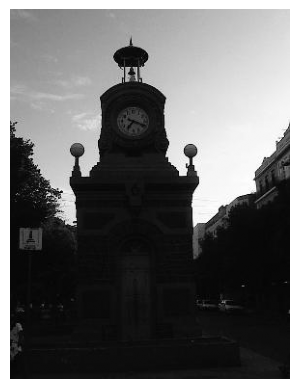

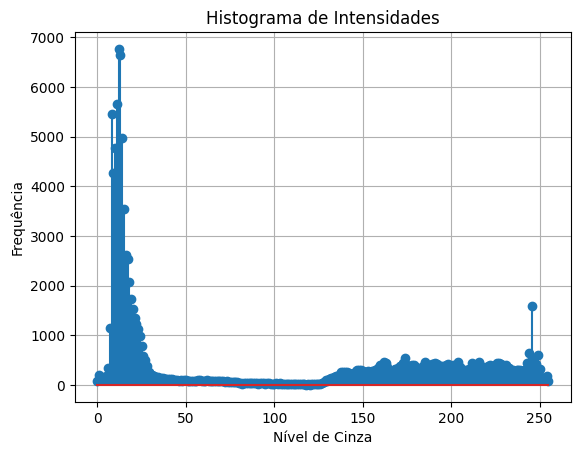

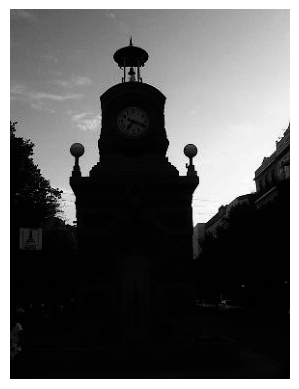

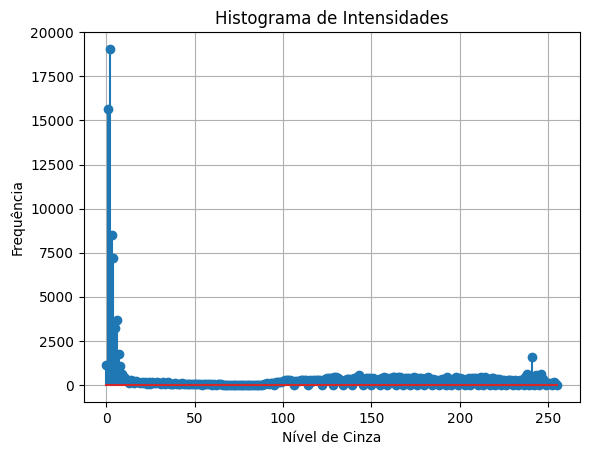

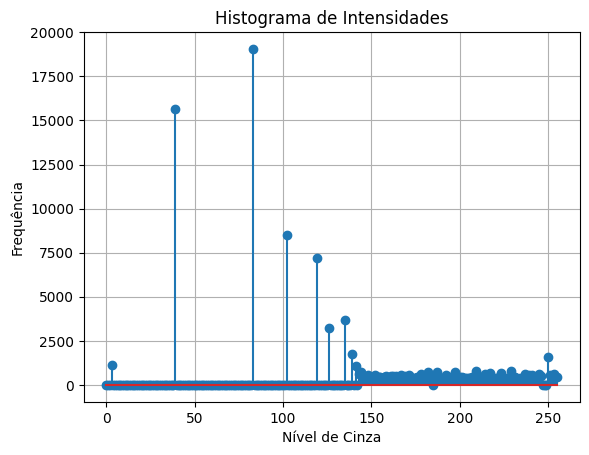

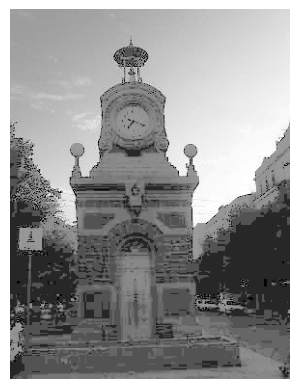

In [ ]:
caminho_base = "/content/drive/MyDrive/Estudos/UFRN/Semestres/13º/PDI - PROCESSAMENTO DIGITAL DE IMAGENS/Unidade I"
imagem = ImagePGMHelper()
imagem.load(caminho_base+"/relogio.pgm")
imagem.show()
imagem.get_histogram()
imagem.show_hist()
imagem.gamma_transformation(y=1.5)
imagem.show()
imagem.get_histogram()
imagem.show_hist()
imagem.equalize()
imagem.show_hist()
imagem.show()
# gammas = [0.85, 1.1]
# for gamma in gammas:
#     imagem.load("einstein.pgm")
#     imagem.gamma_transformation(y=gamma)
#     imagem.show(name=f"gamma y={gamma}")
#     imagem.get_histogram()

256
384
290


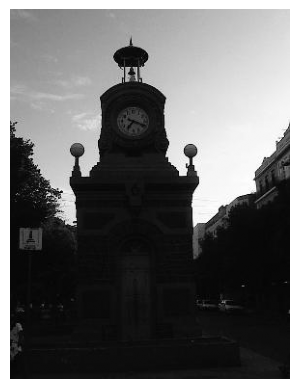

In [ ]:
# Listar arquivos na pasta "MeusArquivos" dentro do Drive
import os

caminho_base = "/content/drive/MyDrive/Estudos/UFRN/Semestres/13º/PDI - PROCESSAMENTO DIGITAL DE IMAGENS/Unidade I"
# # TESTE CAMINHO DO DRIVE
# arquivos = os.listdir(caminho_base)
# print(arquivos)

caminho_img = caminho_base+"/relogio.pgm"

imagem = ImagePGMHelper(caminho_img)
print(imagem.L)
print(imagem.num_linhas)
print(imagem.num_colunas)
imagem.show()


## Filtragem Espacial

### Filtros Estatisticos

<Figure size 640x480 with 0 Axes>

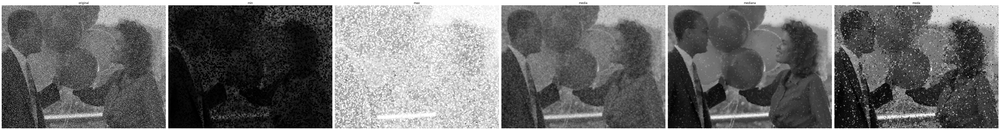

<Figure size 640x480 with 0 Axes>

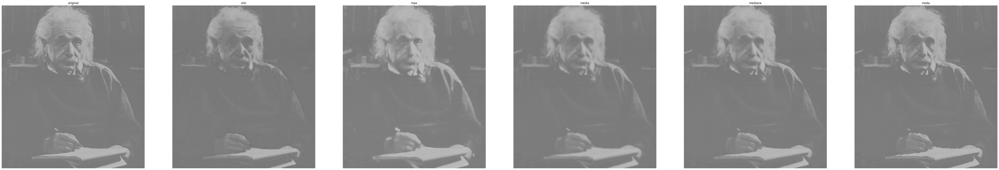

In [7]:
import os
import matplotlib.pyplot as plt

# Caminho da imagem
caminho_base = "/content/drive/MyDrive/Estudos/UFRN/Semestres/13º/PDI - PROCESSAMENTO DIGITAL DE IMAGENS/Unidade I"
# caminho_img = caminho_base + "/testeM.pgm"
caminho_img = caminho_base + "/balloons_noisy.pgm"

# Métricas estatísticas que serão aplicadas
metricas = ["min", "max", "media", "mediana", "moda"]

caminho_img = caminho_base + "/balloons_noisy.pgm"

# Lista para armazenar os objetos com os resultados
imagens_filtradas = []

img = ImagePGMHelper(caminho_img)
imagens_filtradas.append(("original", img.matriz))

# Aplica cada filtro estatístico e armazena resultado
for metrica in metricas:
    img = ImagePGMHelper(caminho_img)
    img.statistical_filter(5, metrica=metrica)
    imagens_filtradas.append((metrica, img.matriz))

# Plot
plt.clf()
plt.figure(figsize=(10 * len(imagens_filtradas), 10))  # ajuste dinâmico

for i, (metrica, matriz) in enumerate(imagens_filtradas, start=1):
    plt.subplot(1, len(imagens_filtradas), i)
    plt.imshow(matriz, cmap='gray', vmin=0, vmax=255)
    plt.title(metrica)
    plt.axis('off')

plt.tight_layout()
plt.show()

caminho_img = caminho_base + "/testeM.pgm"

# Lista para armazenar os objetos com os resultados
imagens_filtradas = []

img = ImagePGMHelper(caminho_img)
imagens_filtradas.append(("original", img.matriz))

# Aplica cada filtro estatístico e armazena resultado
for metrica in metricas:
    img = ImagePGMHelper(caminho_img)
    img.statistical_filter(5, metrica=metrica)
    imagens_filtradas.append((metrica, img.matriz))

# Plot
plt.clf()
plt.figure(figsize=(10 * len(imagens_filtradas), 10))  # ajuste dinâmico

for i, (metrica, matriz) in enumerate(imagens_filtradas, start=1):
    plt.subplot(1, len(imagens_filtradas), i)
    plt.imshow(matriz, cmap='gray', vmin=0, vmax=255)
    plt.title(metrica)
    plt.axis('off')

plt.tight_layout()
plt.show()


### Filtros de Suavização

<Figure size 640x480 with 0 Axes>

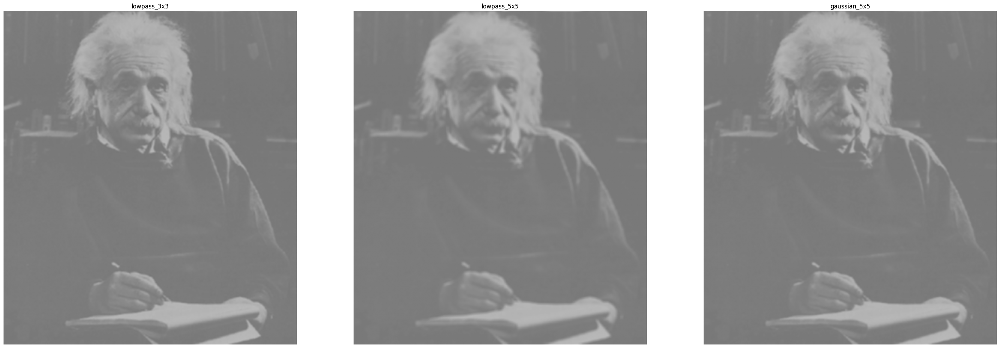

<Figure size 640x480 with 0 Axes>

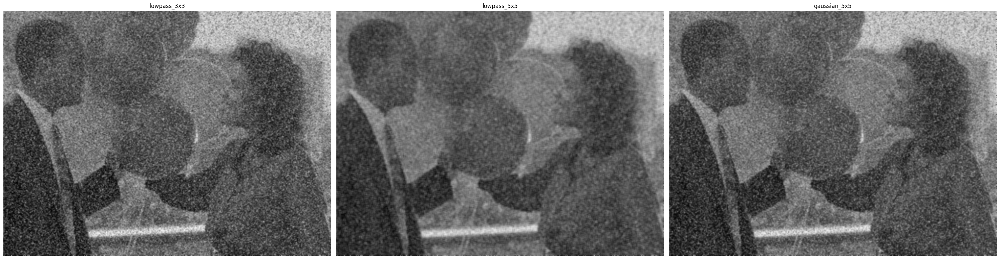

In [8]:
import os
import matplotlib.pyplot as plt

# Caminho da imagem
caminho_base = "/content/drive/MyDrive/Estudos/UFRN/Semestres/13º/PDI - PROCESSAMENTO DIGITAL DE IMAGENS/Unidade I"
caminho_img = caminho_base + "/testeM.pgm"

filters_collection = SpacialFilters()
# print("Filtros disponíveis:", filters_collection.list_filters())


# Métricas estatísticas que serão aplicadas
# filtros = ['lowpass_3x3', 'lowpass_5x5', 'gaussian_5x5', 'laplacian_3x3', 'highpass_5x5', 'sobel_v_3x3', 'sobel_h_3x3']
filtros = ['lowpass_3x3', 'lowpass_5x5', 'gaussian_5x5']

caminho_img = caminho_base + "/testeM.pgm"

# Lista para armazenar os objetos com os resultados
imagens_filtradas = []

# Aplica cada filtro estatístico e armazena resultado
for filter_name in filtros:
    filter = filters_collection.get_filter(filter_name)
    c_mask, mask = filter

    img = ImagePGMHelper(caminho_img)
    img.spacial_filter(c_mask=c_mask, mask=mask)
    imagens_filtradas.append((filter_name, img.matriz))

# Plot
plt.clf()
plt.figure(figsize=(10 * len(imagens_filtradas), 10))  # ajuste dinâmico

for i, (filter_name, matriz) in enumerate(imagens_filtradas, start=1):
    plt.subplot(1, len(imagens_filtradas), i)
    plt.imshow(matriz, cmap='gray', vmin=0, vmax=255)
    plt.title(filter_name)
    plt.axis('off')

plt.tight_layout()
plt.show()

caminho_img = caminho_base + "/balloons_noisy.pgm"

# Lista para armazenar os objetos com os resultados
imagens_filtradas = []

# Aplica cada filtro estatístico e armazena resultado
for filter_name in filtros:
    filter = filters_collection.get_filter(filter_name)
    c_mask, mask = filter

    img = ImagePGMHelper(caminho_img)
    img.spacial_filter(c_mask=c_mask, mask=mask)
    imagens_filtradas.append((filter_name, img.matriz))

# Plot
plt.clf()
plt.figure(figsize=(10 * len(imagens_filtradas), 10))  # ajuste dinâmico

for i, (filter_name, matriz) in enumerate(imagens_filtradas, start=1):
    plt.subplot(1, len(imagens_filtradas), i)
    plt.imshow(matriz, cmap='gray', vmin=0, vmax=255)
    plt.title(filter_name)
    plt.axis('off')

plt.tight_layout()
plt.show()


### Filtros de Bordas

#### Derivada Linear

Temos que a derivada de primeira ordem um sistema discreto pode ser dada por

$$
\frac{\partial f}{\partial x} = f(x + 1) - f(x)
$$

temos também que a segunda ordem desse conceito é

$$
\frac{\partial^2 f}{\partial x^2} = f(x+1) + f(x-1) - 2f(x)
$$

Sabemos que a derivada representa a tendencia da função. Logo, utilizando a derivada podemos perceber os graus de variação de uma função.

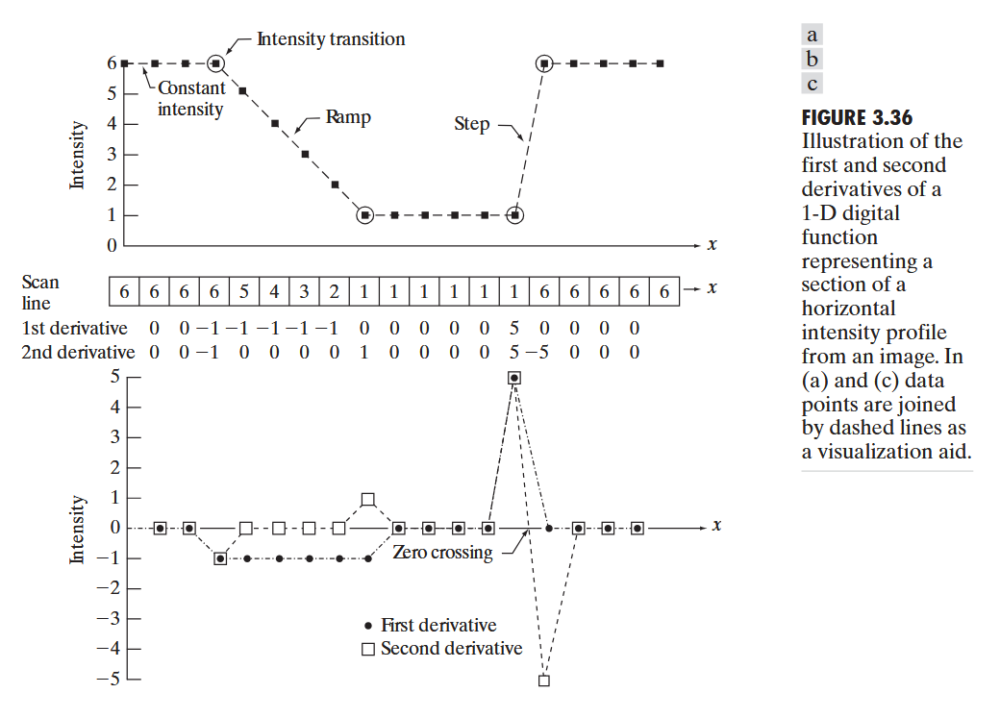

Ao calcular a primeira derivada em uma localização x, subtraímos o valor da função naquela localização do próximo ponto. Portanto, esta é uma operação de "antecipação". Para calcular a segunda derivada em x, usamos os pontos anterior e posterior na computação. Para evitar uma situação em que os pontos anterior ou posterior estejam fora da faixa da linha de varredura, mostramos os cálculos das derivadas na Fig. 3.36 desde o segundo até o penúltimo ponto na sequência.

Nas imagens as transições de cores apresentam essas rampas. Então utilizar esses conceitos nos ajudam a identificar as transições entre as cores. Quanto mais abruptas, mais descatadas. O que é o caso das bordas.

- **Lapaciano**

$$
\nabla^2 f = \frac{\partial^2 f}{\partial x^2} + \frac{\partial^2 f}{\partial y^2}
$$

onde

$$
\frac{\partial^2 f}{\partial x^2} = f(x + 1, y) + f(x - 1, y) - 2f(x, y)
$$

$$
\frac{\partial^2 f}{\partial y^2} = f(x, y + 1) + f(x, y - 1) - 2f(x, y)
$$

ou seja

$$
\nabla^2 f(x,y) = f(x+1,y) + f(x-1,y) + f(x,y+1) + f(x,y-1) - 4f(x,y)
$$



considerando uma mascara

$$
\mathbf{K} = \begin{bmatrix}
z_1 & z_2 & z_3 \\
z_4 & z_5 & z_6 \\
z_7 & z_8 & z_9
\end{bmatrix}
$$

Se aplicarmos esse conceito em uma matriz de mascara para filtragem espacial teremos


$$
\mathbf{K} = \begin{bmatrix}
0 & 1 & 0 \\
1 & -4 & 1 \\
0 & 1 & 0
\end{bmatrix}
$$

podemos usar esse mesmo conceito e extender para as direções diagonais e obter

$$
\mathbf{K} = \begin{bmatrix}
-1 & -1 & -1 \\
-1 & 8 & -1 \\
-1 & -1 & -1
\end{bmatrix}
$$


#### Gradiente

Outra métrica que podemos utilizar é módulo do gradiente

$$
\nabla f = \operatorname{grad}(f) =
\begin{bmatrix}
g_x \\
g_y
\end{bmatrix} =
\begin{bmatrix}
\frac{\partial f}{\partial x} \\[0.5em]
\frac{\partial f}{\partial y}
\end{bmatrix}
$$

O módulo é dado por
$$
M(x, y) = \|\nabla f\| = \sqrt{g_x^2 + g_y^2}
$$

Como os componentes do vetor gradiente são derivadas, eles são operadores lineares. No entanto, a magnitude desse vetor não é, devido às operações de quadrado e raiz quadrada. Por outro lado, as derivadas parciais não são invariantes a rotações (isotrópicas), mas a magnitude do vetor gradiente é.

podemos fazer uma aproximação do módulo por

$$
M(x, y) \approx |g_x| + |g_y|
$$

considerando uma mascara

$$
\mathbf{K} = \begin{bmatrix}
z_1 & z_2 & z_3 \\
z_4 & z_5 & z_6 \\
z_7 & z_8 & z_9
\end{bmatrix}
$$

O Roberts define que podemos fazer

$$
\begin{aligned}
g_x &= (z_9 - z_5) \quad \text{(Horizontal derivative)} \\
g_y &= (z_8 - z_6) \quad \text{(Vertical derivative)}
\end{aligned}
$$

logo teremos

$$
M(x,y) \approx |z_9 - z_5| + |z_8 - z_6|
$$

desse modo podemos fazer as matrizes

$$
\mathbf{K} = \begin{bmatrix}
-1 & 0 \\
0 & 1 \\
\end{bmatrix}
$$

e

$$
\mathbf{K} = \begin{bmatrix}
0 & -1 \\
1 & 0 \\
\end{bmatrix}
$$



Porém, Máscaras de tamanhos pares são difíceis de implementar porque não possuem um centro de simetria. As menores máscaras de filtro que nos interessam têm tamanho 3x3.

expandindo esse conceito para uma matriz 3x3 podemos fazer

$$
\begin{aligned}
g_x &= \frac{\partial f}{\partial x} = (z_7 + 2z_8 + z_9) - (z_1 + 2z_2 + z_3) \\
g_y &= \frac{\partial f}{\partial y} = (z_3 + 2z_6 + z_9) - (z_1 + 2z_4 + z_7)
\end{aligned}
$$

o que nos geram as matrizes de Sobel, dadas por

$$
\mathbf{K} = \begin{bmatrix}
-1 & -2 & -1 \\
0 & 0 & 0 \\
1 & 2 & 1
\end{bmatrix}
$$

$$
\mathbf{K} = \begin{bmatrix}
-1 & 0 & 1 \\
-2 & 0 & 2 \\
-1 & 0 & 1
\end{bmatrix}
$$

#### Demonstração dos Filtros

<Figure size 640x480 with 0 Axes>

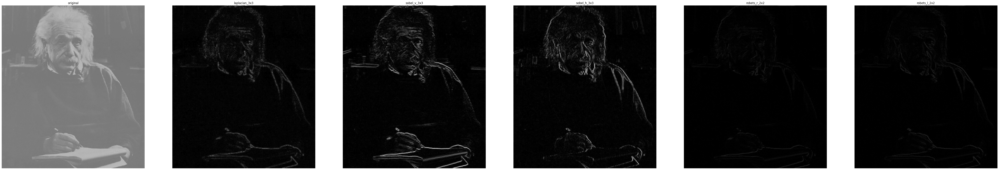

<Figure size 640x480 with 0 Axes>

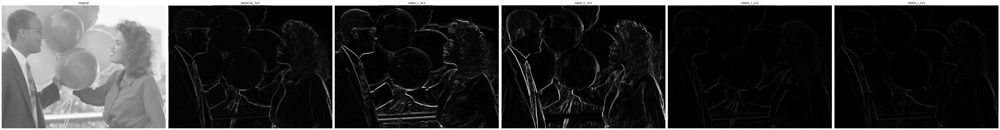

<Figure size 640x480 with 0 Axes>

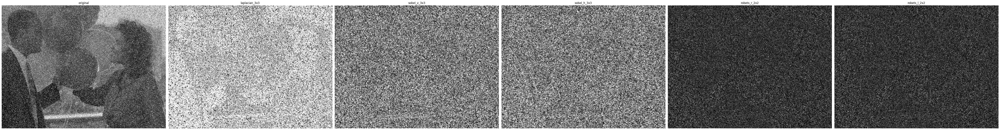

In [12]:
import os
import matplotlib.pyplot as plt

# Caminho da imagem
caminho_base = "/content/drive/MyDrive/Estudos/UFRN/Semestres/13º/PDI - PROCESSAMENTO DIGITAL DE IMAGENS/Unidade I"
caminho_img = caminho_base + "/testeM.pgm"

filters_collection = SpacialFilters()
# print("Filtros disponíveis:", filters_collection.list_filters())


# Métricas estatísticas que serão aplicadas
# filtros = ['lowpass_3x3', 'lowpass_5x5', 'gaussian_5x5', 'laplacian_3x3', 'highpass_5x5', 'sobel_v_3x3', 'sobel_h_3x3', 'robets_r_2x2', 'robets_l_2x2']
filtros = ['laplacian_3x3', 'sobel_v_3x3', 'sobel_h_3x3', 'robets_r_2x2', 'robets_l_2x2']

# Lista para armazenar os objetos com os resultados
imagens_filtradas = []

img = ImagePGMHelper(caminho_img)
imagens_filtradas.append(("original", img.matriz))

# Aplica cada filtro estatístico e armazena resultado
for filter_name in filtros:
    filter = filters_collection.get_filter(filter_name)
    c_mask, mask = filter

    img = ImagePGMHelper(caminho_img)
    img.spacial_filter(c_mask=c_mask, mask=mask)
    imagens_filtradas.append((filter_name, img.matriz))

# Plot
plt.clf()
plt.figure(figsize=(10 * len(imagens_filtradas), 10))  # ajuste dinâmico

for i, (filter_name, matriz) in enumerate(imagens_filtradas, start=1):
    plt.subplot(1, len(imagens_filtradas), i)
    plt.imshow(matriz, cmap='gray', vmin=0, vmax=255)
    plt.title(filter_name)
    plt.axis('off')

plt.tight_layout()
plt.show()

# ----------------------------------------------------------------------------

caminho_img = caminho_base + "/balloons.pgm"

# Lista para armazenar os objetos com os resultados
imagens_filtradas = []

img = ImagePGMHelper(caminho_img)
imagens_filtradas.append(("original", img.matriz))

# Aplica cada filtro estatístico e armazena resultado
for filter_name in filtros:
    filter = filters_collection.get_filter(filter_name)
    c_mask, mask = filter

    img = ImagePGMHelper(caminho_img)
    img.spacial_filter(c_mask=c_mask, mask=mask)
    imagens_filtradas.append((filter_name, img.matriz))

# Plot
plt.clf()
plt.figure(figsize=(10 * len(imagens_filtradas), 10))  # ajuste dinâmico

for i, (filter_name, matriz) in enumerate(imagens_filtradas, start=1):
    plt.subplot(1, len(imagens_filtradas), i)
    plt.imshow(matriz, cmap='gray', vmin=0, vmax=255)
    plt.title(filter_name)
    plt.axis('off')

plt.tight_layout()
plt.show()

# ----------------------------------------------------------------------------

caminho_img = caminho_base + "/balloons_noisy.pgm"

# Lista para armazenar os objetos com os resultados
imagens_filtradas = []

img = ImagePGMHelper(caminho_img)
imagens_filtradas.append(("original", img.matriz))

# Aplica cada filtro estatístico e armazena resultado
for filter_name in filtros:
    filter = filters_collection.get_filter(filter_name)
    c_mask, mask = filter

    img = ImagePGMHelper(caminho_img)
    img.spacial_filter(c_mask=c_mask, mask=mask)
    imagens_filtradas.append((filter_name, img.matriz))

# Plot
plt.clf()
plt.figure(figsize=(10 * len(imagens_filtradas), 10))  # ajuste dinâmico

for i, (filter_name, matriz) in enumerate(imagens_filtradas, start=1):
    plt.subplot(1, len(imagens_filtradas), i)
    plt.imshow(matriz, cmap='gray', vmin=0, vmax=255)
    plt.title(filter_name)
    plt.axis('off')

plt.tight_layout()
plt.show()


## Testes

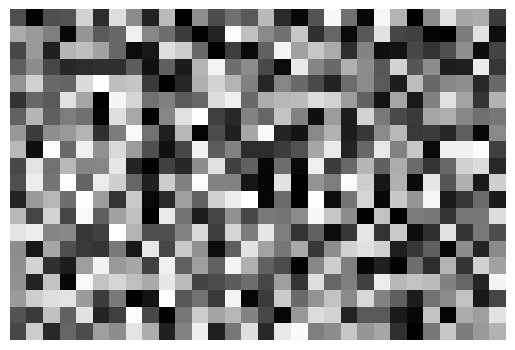

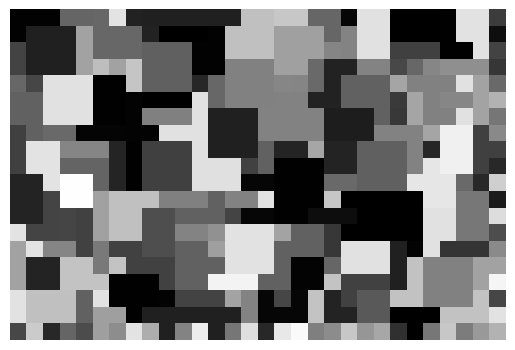

In [ ]:
import numpy as np

# Criação da matriz 20x30 com números aleatórios entre 0 e 255
matriz_img = np.random.randint(0, 256, size=(20, 30))
# matriz_random

plt.imshow(matriz_img, cmap='gray', vmin=0, vmax=255)
plt.axis('off')  # remove eixos
plt.show()

# Criação da matriz 3x3 com todos os valores 1
mask = np.ones((3, 3))
c_mask = 1/9
# print(matriz_ones)

def conv_filter_teste(image, mask, c_mask):
  """faz a convolucao de um filtro espacial em uma matriz de uma figura"""
  n_masklin, n_maskcol = np.shape(mask)

  new_matriz_img = np.zeros(np.shape(matriz_img))

  nlinhas, ncolunas = np.shape(matriz_img)
  # print(f"Linhas: {nlinhas}, Colunas: {ncolunas}")

  # PERCORRE A IMAGEM
  for x in range(nlinhas):
      for y in range(ncolunas):
          r = matriz_img[x][y]
          # print(f"({x},{y}) = {r}")
          # PERCORRE A MASCARA NO PONTO DA IMAGEM
          sum = 0
          adjust_x = x - (n_masklin // 2)
          adjust_y = y - (n_maskcol // 2)
          for i in range(n_masklin):
              for j in range(n_maskcol):
                  try:
                      sum += c_mask * mask[i][j] * matriz_img[adjust_x + i][adjust_y + j]
                  except:
                      # print(f"pos {adjust_x + i},{adjust_y + j} deu pau")
                      sum += c_mask * mask[i][j] * r
          # seta valor filtradon na nova imagem
          new_matriz_img[x][y] = int(sum)
          # print(f"({x},{y}) = {r} -> {sum}")
  return new_matriz_img

def statist_filter_teste(image, mask_size, metrica="moda"):
  """Executa um filtro estatistico na imagem"""

  mask = np.ones((mask_size, mask_size))

  n_masklin, n_maskcol = np.shape(mask)

  new_matriz_img = np.zeros(np.shape(image))

  nlinhas, ncolunas = np.shape(image)
  # print(f"Linhas: {nlinhas}, Colunas: {ncolunas}")

  # PERCORRE A IMAGEM
  for x in range(nlinhas):
      for y in range(ncolunas):
          r = matriz_img[x][y]
          # PERCORRE A MASCARA NO PONTO DA IMAGEM
          region_values = []
          adjust_x = x - (n_masklin // 2)
          adjust_y = y - (n_maskcol // 2)
          for i in range(n_masklin):
              for j in range(n_maskcol):
                  try:
                      region_values.append(matriz_img[adjust_x + i][adjust_y + j])
                  except:
                      region_values.append(r)
          result = 0
          if metrica == "moda":
              result = max(set(region_values), key=region_values.count)
          elif metrica == "mediana":
              result = np.median(region_values)
          elif metrica == "media":
              result = np.mean(region_values)
          elif metrica == "max":
              result = max(region_values)
          elif metrica == "min":
              result = min(region_values)

          # seta valor filtradon na nova imagem
          new_matriz_img[x][y] = int(result)
  return new_matriz_img

# new_matriz_img = conv_filter_teste(matriz_img, mask, c_mask)
new_matriz_img = statist_filter_teste(matriz_img, 3, metrica="moda")

plt.imshow(new_matriz_img, cmap='gray', vmin=0, vmax=255)
plt.axis('off')  # remove eixos
plt.show()

Filtros disponíveis: ['gaussian_5x5', 'highpass_5x5', 'lowpass_5x5', 'lowpass_3x3', 'laplacian_3x3', 'sobel_v_3x3', 'sobel_h_3x3']


<Figure size 640x480 with 0 Axes>

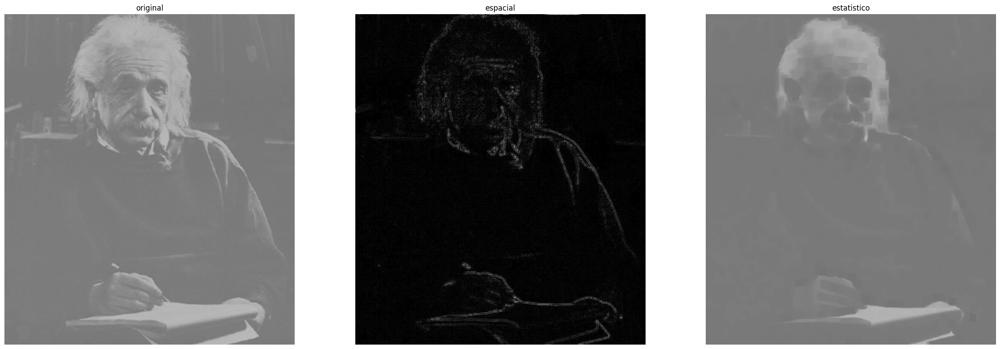

In [ ]:
# Listar arquivos na pasta "MeusArquivos" dentro do Drive
import os

caminho_base = "/content/drive/MyDrive/Estudos/UFRN/Semestres/13º/PDI - PROCESSAMENTO DIGITAL DE IMAGENS/Unidade I"
# # TESTE CAMINHO DO DRIVE
# arquivos = os.listdir(caminho_base)
# print(arquivos)

caminho_img = caminho_base+"/testeM.pgm"

filters_collection = SpacialFilters()
print("Filtros disponíveis:", filters_collection.list_filters())

# COLETA FILTRO ESPACIAL
filter = filters_collection.get_filter("laplacian_3x3")
c_mask, mask = filter

# CRIA OBJETO E APLICA FILTRO ESPACIAL
imagem1 = ImagePGMHelper(caminho_img)
imagem1.spacial_filter(mask, c_mask)

# CRIA OBJETO E APLICA FILTRO ESTATISTICO
imagem2 = ImagePGMHelper(caminho_img)
imagem2.statistical_filter(10, metrica="min")

# Criar figura com 3 subplots lado a lado
plt.clf()
plt.figure(figsize=(24, 8))  # largura x altura em polegadas

plt.subplot(1, 3, 1)
plt.imshow(imagem1.matriz_original, cmap='gray', vmin=0, vmax=255)
plt.title('original')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(imagem1.matriz, cmap='gray', vmin=0, vmax=255)
plt.title('espacial')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(imagem2.matriz, cmap='gray', vmin=0, vmax=255)
plt.title('estatistico')
plt.axis('off')

plt.tight_layout()
plt.show()